### Data Project 4 | Parte II: Model/ Image Classification
# Clasificación de imágenes de Rayos X
Grupo Los GermaÑoles: Maria, Franzi y Nacho

In a nutchell, we covered how to train an image classifier model in six steps:
1. We downloaded some training images online;
2. We loaded those images into memory;
3. We trained a baseline (first-pass) model;
4. We figured out what the model learnt;
5. We ran predictions on our baseline model; and,
6. We made improvements to the baseline model to make it even better.

# Libraries

In [ ]:
!pip install albumentations
!pip install fastai
!pip install --upgrade fastai

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
# Basic libraries
import warnings
from google.colab import drive
import pandas as pd
import os
import random

# Image Processing/ Visualization
import matplotlib.pyplot as plt
from PIL import Image


# Neural Network Regression (NNR) models
from fastai.vision.augment import aug_transforms
from fastai.vision.all import *
from fastai.vision import *
from fastai.vision.widgets import ImageClassifierCleaner

# Set directories

In [ ]:
warnings.filterwarnings("ignore")
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Define paths to data folders
path = "/content/drive/MyDrive//dataproject"
train = "/content/drive/MyDrive/dataproject/train_franzi"
test = "/content/drive/MyDrive/dataproject/test_franzi"

# Load data (incl. transformations)

In [ ]:
# Load data
batch_size = 8
size = 256

# Load data with transformations (normailzation & data augmentation)
data = ImageDataLoaders.from_folder(
    path= train,
    train=train,
    test=test,
    valid_pct=0.1,
    item_tfms=Resize(size, method=ResizeMethod.Pad, pad_mode=PadMode.Zeros),
    batch_tfms=Normalize.from_stats(*imagenet_stats),
    aug_tfms=aug_transforms,
    bs=batch_size,
    shuffle=True
)

In [ ]:
# Show classes
target_labels = data.vocab
target_labels

['0', '1', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '2', '20', '21', '3', '4', '5', '6', '7', '8', '9']

# Preview data

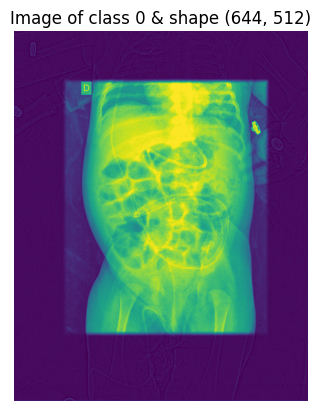

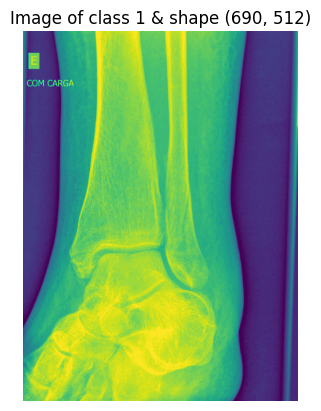

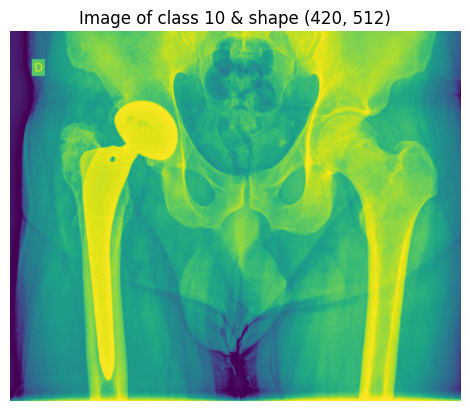

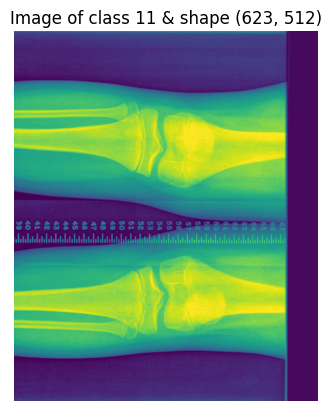

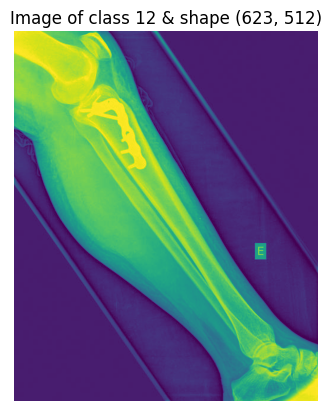

...

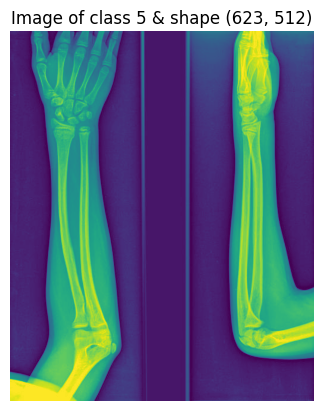

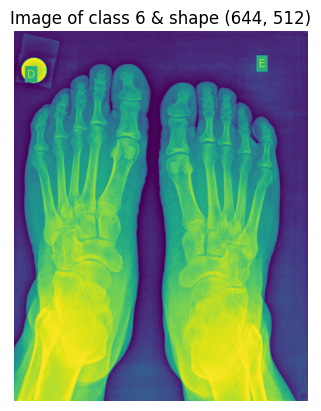

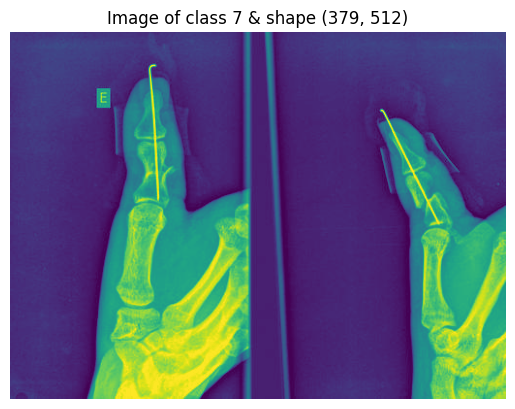

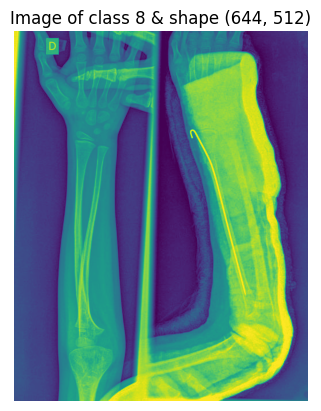

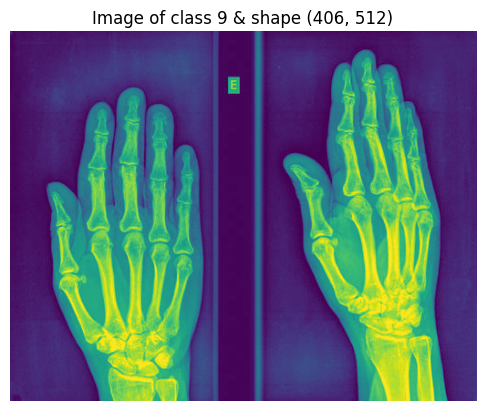

In [ ]:
# Create a dictionary to store the image paths for each label
image_paths = {label: [] for label in target_labels}

# Traverse the folder and collect image paths for each label
for label in target_labels:
    label_path = os.path.join(train, label)
    image_paths[label] = [os.path.join(label_path, file) for file in os.listdir(label_path) if file.endswith(".jpg")]

# Display one random image per class
for label, paths in image_paths.items():
    if paths:
        random_path = random.choice(paths)
        image = Image.open(random_path)
        plt.imshow(image)
        plt.title(f"Image of class {label} & shape {image.shape}")
        plt.axis('off')
        plt.show()
    else:
        print(f"No images found for class {label}.")


# Train model

In [ ]:
# Create the model
learn = cnn_learner(data, models.densenet201, metrics=accuracy)

Downloading: "https://download.pytorch.org/models/densenet201-c1103571.pth" to /root/.cache/torch/hub/checkpoints/densenet201-c1103571.pth
100%|██████████| 77.4M/77.4M [00:00<00:00, 291MB/s]


In [ ]:
# Show model summary
learn.model

Sequential(
  (0): Sequential(
    (0): Sequential(
      (conv0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (norm0): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu0): ReLU(inplace=True)
      (pool0): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (denseblock1): _DenseBlock(
        (denselayer1): _DenseLayer(
          (norm1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (relu1): ReLU(inplace=True)
          (conv1): Conv2d(64, 128, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (norm2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (relu2): ReLU(inplace=True)
          (conv2): Conv2d(128, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        )
        (denselayer2): _DenseLayer(
          (norm1): BatchNorm2d(96, eps=1e-05, momentum=0.1, affine

In [ ]:
# Freeze the model
learn.data = data
learn.freeze()

SuggestedLRs(valley=0.0006918309954926372)

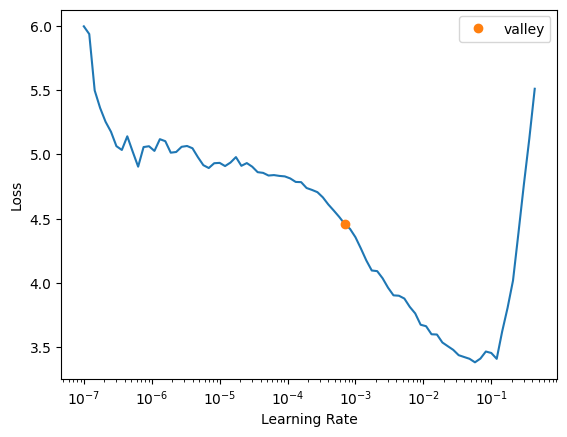

In [ ]:
# Find the learning rate
learn.lr_find()

In [ ]:
# Set learning rate
lr = 1e-2

In [ ]:
# Train 25 epochs
learn.fit_one_cycle(25)

epoch,train_loss,valid_loss,accuracy,time
0,2.766079,1.167779,0.669291,00:31
1,1.291165,0.596889,0.803150,00:26
2,0.772772,0.498531,0.874016,00:22
3,0.545047,0.479999,0.897638,00:23
4,0.488403,0.681914,0.874016,00:24
5,0.480183,0.486092,0.905512,00:23
6,0.345974,0.502313,0.889764,00:23
7,0.345747,0.497336,0.897638,00:23
8,0.328137,0.620227,0.905512,00:23
9,0.203635,0.547995,0.874016,00:23


In [ ]:
# Save model
learn.save("model_a")

Path('/content/drive/MyDrive/dataproject/train_franzi/models/franzi_model_0706_a.pth')

In [ ]:
# Unfreeze conv layers
learn.unfreeze()

In [ ]:
# Set learning rate
lr = 1e-5

In [ ]:
# Train 25 epochs
learn.fit_one_cycle(25, lr_max=slice(lr/100,lr))

epoch,train_loss,valid_loss,accuracy,time
0,0.021091,0.484927,0.921260,00:29
1,0.021209,0.479322,0.921260,00:28
2,0.010693,0.504696,0.913386,00:28
3,0.024051,0.483880,0.921260,00:29
4,0.008122,0.457514,0.929134,00:28
5,0.019265,0.452927,0.913386,00:28
6,0.027557,0.479062,0.921260,00:29
7,0.012403,0.483146,0.929134,00:29
8,0.014503,0.431853,0.929134,00:29
9,0.029788,0.469347,0.921260,00:30


In [ ]:
# Save model
learn.save("model_b")

Path('/content/drive/MyDrive/dataproject/train_franzi/models/franzi_model_0706_b.pth')

# Interpret model

In [ ]:
# Create a Classification Interpreter
learning_interpreter = ClassificationInterpretation.from_learner(learn)

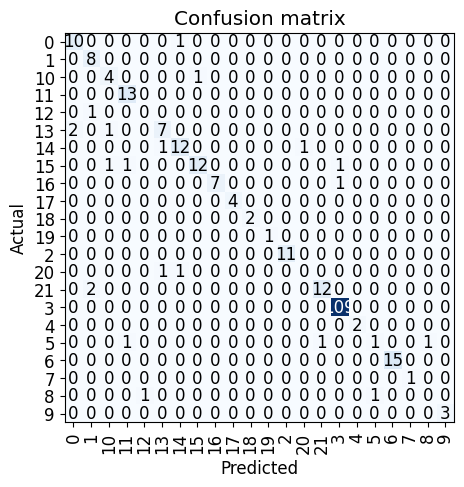

In [ ]:
# Plot confusion matrix for correct  vs. incorrect predictions
learning_interpreter.plot_confusion_matrix()

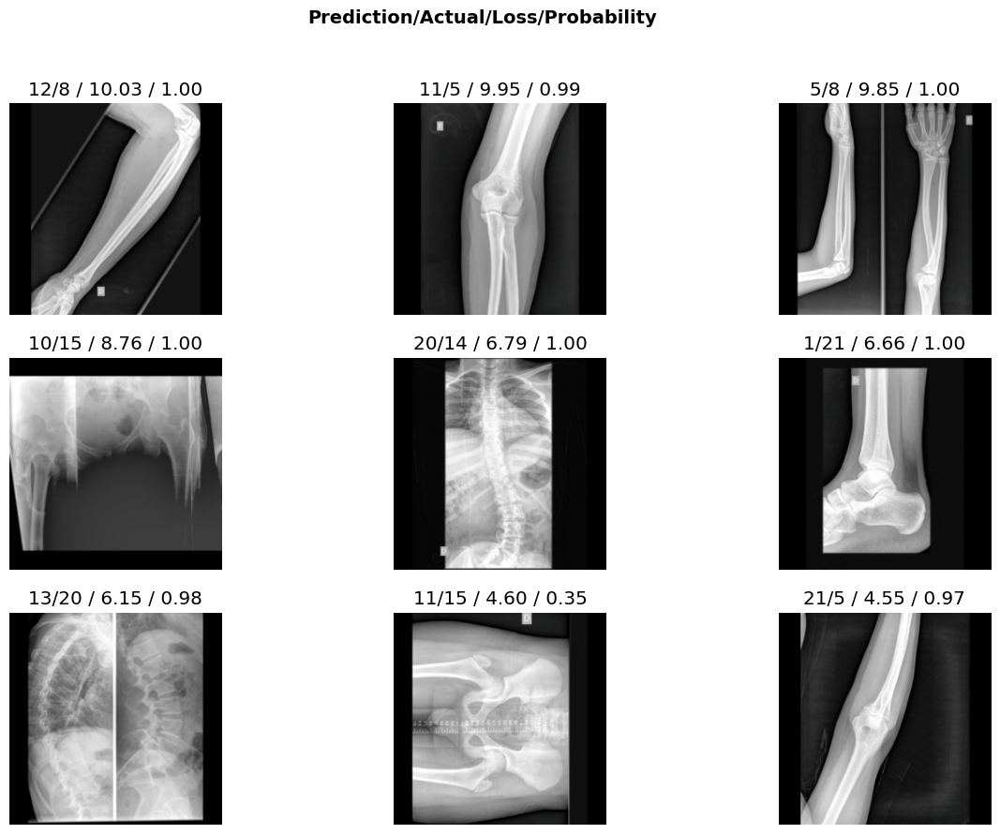

In [ ]:
# View images with incorrect predictions (top losses)
learning_interpreter.plot_top_losses(9, figsize=(15, 10))

# Improve model

In [ ]:
# Prune away mistakes/ bad data
dataset_cleaner = ImageClassifierCleaner(learn, max_n=100)
dataset_cleaner

In [ ]:
# Move misclassified images
for i, new_label in dataset_cleaner.change():
    image = dataset_cleaner.fns[i]
    new_path = train  + "/" + str(i)
    ! mv "$image" "$new_path"
    print(f' Moved {image} into {new_path}')

* Moving misclassified images:
 Moved /content/drive/MyDrive/dataproject/train_franzi/21/1.2.826.0.1.3680043.8.498.33922674591830572451916649661311612715.jpg into /content/drive/MyDrive/dataproject/train_franzi/9


# Predict on new images (test)

In [ ]:
# Read test files
test_df = pd.read_csv('/content/drive/MyDrive/dataproject/sample_submission.csv')

# Create new loader for the sake of path, which if different from the training path
tdls = ImageDataLoaders.from_df(test_df,
                                path=test,
                                suff='.jpg',
                                valid_pct=0.2,
                                ds_tfms=aug_transforms(),
                                size=size,
                                batch_tfms=Normalize.from_stats(*imagenet_stats),
                                item_tfms=Resize(size, method=ResizeMethod.Pad, pad_mode=PadMode.Zeros),
                                bs=batch_size,
                                shuffle=False
                                )
test_dl = tdls.test_dl(test_df)

In [ ]:
# Create predictions on test data
preds = learn.tta(dl=test_dl, n=64, use_max=False)

NameError: ignored

In [ ]:
# Savev predictions as DataFrame & csv
predss = learn.dls.vocab[np.argmax(preds[0], axis=1)]
test_df['Target'] = predss
submission_df = test_df[['SOPInstanceUID', 'Target']]
submission_df.to_csv(f'sample_submission_result2.csv', header=True, index=False)
submission_df

,SOPInstanceUID,Target
0,1.2.826.0.1.3680043.8.498.75932240489221075589097397484896361550,3
1,1.2.826.0.1.3680043.8.498.80518330963406833915089209886834390159,11
2,1.2.826.0.1.3680043.8.498.97413731471864060627365739417678218380,11
3,1.2.826.0.1.3680043.8.498.98229201581139590153090960568103270985,2
4,1.2.826.0.1.3680043.8.498.84551354213532970228348448377009898172,3
...,...,...
323,1.2.826.0.1.3680043.8.498.60964782211363234805993194732570333546,5
324,1.2.826.0.1.3680043.8.498.90617059056548212763113895515703343197,16
325,1.2.826.0.1.3680043.8.498.77795747668217965858748681496943891312,3
326,1.2.826.0.1.3680043.8.498.83898837859028979514441043450695737481,6
